<a href="https://colab.research.google.com/github/markredito/kpop_diffusion/blob/main/ddm_kpop_128.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Goal: Finetune a previously trained model on higher resolution images. Target = 128px

## Imports and Packages

In [ ]:
!pip install wandb

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.7/6.7 MB 24.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 22.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 277.3/277.3 kB 23.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 8.8 MB/s eta 0:00:00


In [ ]:
import numpy as np
import matplotlib.pyplot as plt

plt.style.use("seaborn-v0_8-colorblind")

import math

import tensorflow as tf
from tensorflow.keras import (
    layers,
    models,
    optimizers,
    utils,
    callbacks,
    metrics,
    losses,
    activations
)

from tensorflow.keras.callbacks import ReduceLROnPlateau

In [ ]:
import wandb
from wandb.keras import WandbCallback

# wandb login
wandb.login(key="API_KEY")

wandb: W&B API key is configured. Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


True

### Some helper functions

In [ ]:
#helper functions
def sample_batch(dataset):
    # Attempt to take one batch from the dataset
    for batch in dataset.take(1):
        # Check the structure of the batch
        print("Batch structure:", type(batch))
        if isinstance(batch, tuple):
            batch = batch[0]  # Assuming the first element is the images if it's a tuple

        # Convert to numpy and ensure it's a 4D array
        batch = np.array(batch)
        print("Shape of batch after conversion:", batch.shape)

        # Reduce dimensions if necessary
        if batch.ndim > 4:
            batch = batch[0]  # Take the first element to reduce one dimension, if there are extra
        return batch


def display(images, n=5, size=(20, 3), as_type="float32", save_to=None): #replaced n=10 to 5
    """
    Displays n random images from each one of the supplied arrays.
    """
    if images.ndim == 4:  # Assuming images have shape (batch_size, height, width, channels)
        if images.shape[0] < n:
            n = images.shape[0]  # Adjust n if there are fewer images than requested
        plt.figure(figsize=size)
        for i in range(n):
            plt.subplot(1, n, i + 1)
            img = images[i].astype(as_type)
            if img.max() > 1.0:
                img = img / 255.0  # Normalize if max value indicates non-normalized data
            plt.imshow(img)
            plt.axis("off")
    else:
        raise TypeError("Input images are expected to be four-dimensional")

    if save_to:
        plt.savefig(save_to)
        print(f"\nSaved to {save_to}")

    plt.show()

## Model Parameters

In [ ]:
# Parameters
IMAGE_SIZE = 128
BATCH_SIZE = 128
DATASET_REPETITIONS = 5
LOAD_MODEL = True #typically false if starting from scratch

NOISE_EMBEDDING_SIZE = 32
PLOT_DIFFUSION_STEPS = 20

# optimization
EMA = 0.995 #before 0.999
LEARNING_RATE = 5e-5 #before: 1e-3, 1e-4, 2e-4
WEIGHT_DECAY = 1e-4
EPOCHS = 50 #originally 50

## Data Preprocessing

### Connect Google Drive

In [ ]:
# Load the data
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### Preprocess Images

In [ ]:
def preprocess(img):
    # Normalize and ensure image shape consistency
    img = tf.image.resize(img, [IMAGE_SIZE, IMAGE_SIZE])  # Ensure all images are the same size
    img = tf.cast(img, tf.float32) / 255.0
    return img

# Load images
train_data = tf.keras.utils.image_dataset_from_directory(
    '/content/drive/MyDrive/ML_experiments/Datasets/kpop2',
    image_size=(IMAGE_SIZE, IMAGE_SIZE),
    batch_size=BATCH_SIZE,
    label_mode=None  # Ensure no labels are used
)

# Map preprocessing function
train = train_data.map(preprocess)

# Check data
for images in train.take(10):  # Check the first 10 batches
    print(images.shape)  # This should now be (BATCH_SIZE, IMAGE_SIZE, IMAGE_SIZE, 3)


Found 4482 files belonging to 1 classes.
(128, 128, 128, 3)
(128, 128, 128, 3)
(128, 128, 128, 3)
(128, 128, 128, 3)
(128, 128, 128, 3)
(128, 128, 128, 3)
(128, 128, 128, 3)
(128, 128, 128, 3)
(128, 128, 128, 3)
(128, 128, 128, 3)


### Display some images from the dataset

Batch structure: <class 'tensorflow.python.framework.ops.EagerTensor'>
Shape of batch after conversion: (64, 128, 128, 3)


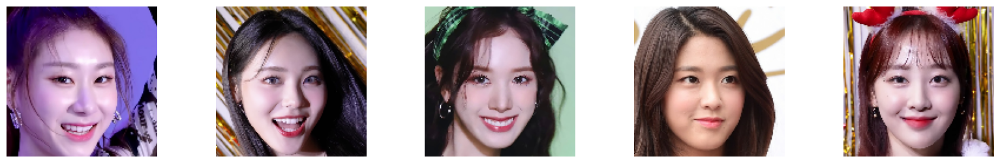

In [ ]:
# Show some images from the train dataset
train_sample = sample_batch(train)
display(train_sample)

## The Model

### Diffusion Schedules

In [ ]:
def linear_diffusion_schedule(diffusion_times):
    min_rate = 0.0001
    max_rate = 0.02
    betas = min_rate + diffusion_times * (max_rate - min_rate)
    alphas = 1 - betas
    alpha_bars = tf.math.cumprod(alphas)
    signal_rates = tf.sqrt(alpha_bars)
    noise_rates = tf.sqrt(1 - alpha_bars)
    return noise_rates, signal_rates

In [ ]:
def cosine_diffusion_schedule(diffusion_times):
    signal_rates = tf.cos(diffusion_times * math.pi / 2)
    noise_rates = tf.sin(diffusion_times * math.pi / 2)
    return noise_rates, signal_rates

In [ ]:
def offset_cosine_diffusion_schedule(diffusion_times):
    min_signal_rate = 0.02
    max_signal_rate = 0.95
    start_angle = tf.acos(max_signal_rate)
    end_angle = tf.acos(min_signal_rate)

    diffusion_angles = start_angle + diffusion_times * (end_angle - start_angle)

    signal_rates = tf.cos(diffusion_angles)
    noise_rates = tf.sin(diffusion_angles)

    return noise_rates, signal_rates

In [ ]:
T = 1000
diffusion_times = tf.convert_to_tensor([x / T for x in range(T)])
linear_noise_rates, linear_signal_rates = linear_diffusion_schedule(
    diffusion_times
)
cosine_noise_rates, cosine_signal_rates = cosine_diffusion_schedule(
    diffusion_times
)
(
    offset_cosine_noise_rates,
    offset_cosine_signal_rates,
) = offset_cosine_diffusion_schedule(diffusion_times)

### Visualize diffusion schedules (Signal and Noise)

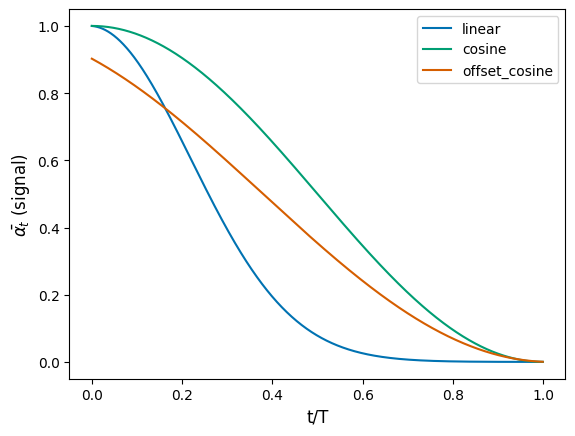

In [ ]:
plt.plot(
    diffusion_times, linear_signal_rates**2, linewidth=1.5, label="linear"
)
plt.plot(
    diffusion_times, cosine_signal_rates**2, linewidth=1.5, label="cosine"
)
plt.plot(
    diffusion_times,
    offset_cosine_signal_rates**2,
    linewidth=1.5,
    label="offset_cosine",
)

plt.xlabel("t/T", fontsize=12)
plt.ylabel(r"$\bar{\alpha_t}$ (signal)", fontsize=12)
plt.legend()
plt.show()

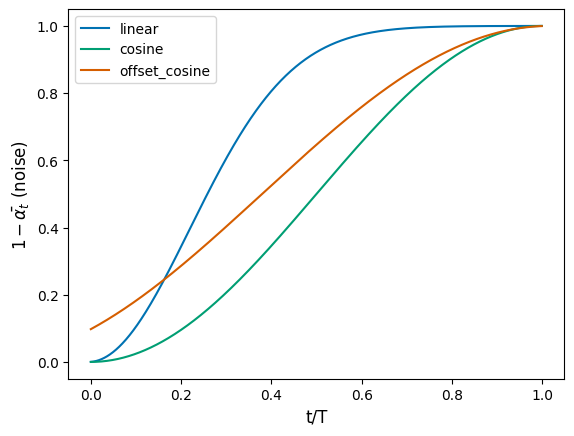

In [ ]:
plt.plot(
    diffusion_times, linear_noise_rates**2, linewidth=1.5, label="linear"
)
plt.plot(
    diffusion_times, cosine_noise_rates**2, linewidth=1.5, label="cosine"
)
plt.plot(
    diffusion_times,
    offset_cosine_noise_rates**2,
    linewidth=1.5,
    label="offset_cosine",
)

plt.xlabel("t/T", fontsize=12)
plt.ylabel(r"$1-\bar{\alpha_t}$ (noise)", fontsize=12)
plt.legend()
plt.show()

## Build the Model

### Sinusoidal Embeddings

In [ ]:
def sinusoidal_embedding(x):
    frequencies = tf.exp(
        tf.linspace(
            tf.math.log(1.0),
            tf.math.log(1000.0),
            NOISE_EMBEDDING_SIZE // 2,
        )
    )
    angular_speeds = 2.0 * math.pi * frequencies
    embeddings = tf.concat(
        [tf.sin(angular_speeds * x), tf.cos(angular_speeds * x)], axis=3
    )
    return embeddings

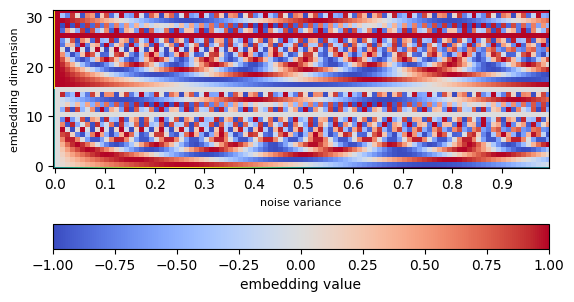

In [ ]:
embedding_list = []
for y in np.arange(0, 1, 0.01):
    embedding_list.append(sinusoidal_embedding(np.array([[[[y]]]]))[0][0][0])
embedding_array = np.array(np.transpose(embedding_list))
fig, ax = plt.subplots()
ax.set_xticks(
    np.arange(0, 100, 10), labels=np.round(np.arange(0.0, 1.0, 0.1), 1)
)
ax.set_ylabel("embedding dimension", fontsize=8)
ax.set_xlabel("noise variance", fontsize=8)
plt.pcolor(embedding_array, cmap="coolwarm")
plt.colorbar(orientation="horizontal", label="embedding value")
ax.imshow(embedding_array, interpolation="nearest", origin="lower")
plt.show()

### The UNET

In [ ]:

def ResidualBlock(width):
    def apply(x):
        input_width = x.shape[3]
        if input_width == width:
            residual = x
        else:
            residual = layers.Conv2D(width, kernel_size=1)(x)
        x = layers.BatchNormalization(center=False, scale=False)(x)
        x = layers.Conv2D(
            width, kernel_size=3, padding="same", activation=activations.swish
        )(x)
        x = layers.Conv2D(width, kernel_size=3, padding="same")(x)
        x = layers.Add()([x, residual])
        return x

    return apply


def DownBlock(width, block_depth):
    def apply(x):
        x, skips = x
        for _ in range(block_depth):
            x = ResidualBlock(width)(x)
            skips.append(x)
        x = layers.AveragePooling2D(pool_size=2)(x)
        return x

    return apply


def UpBlock(width, block_depth):
    def apply(x):
        x, skips = x
        x = layers.UpSampling2D(size=2, interpolation="bilinear")(x)
        for _ in range(block_depth):
            x = layers.Concatenate()([x, skips.pop()])
            x = ResidualBlock(width)(x)
        return x

    return apply

In [ ]:
# Build the U-Net

noisy_images = layers.Input(shape=(IMAGE_SIZE, IMAGE_SIZE, 3))
x = layers.Conv2D(32, kernel_size=1)(noisy_images)

noise_variances = layers.Input(shape=(1, 1, 1))
noise_embedding = layers.Lambda(sinusoidal_embedding)(noise_variances)
noise_embedding = layers.UpSampling2D(size=IMAGE_SIZE, interpolation="nearest")(
    noise_embedding
)

x = layers.Concatenate()([x, noise_embedding])

skips = []

x = DownBlock(32, block_depth=2)([x, skips])
x = DownBlock(64, block_depth=2)([x, skips])
x = DownBlock(96, block_depth=2)([x, skips])

x = ResidualBlock(128)(x)
x = ResidualBlock(128)(x)

x = UpBlock(96, block_depth=2)([x, skips])
x = UpBlock(64, block_depth=2)([x, skips])
x = UpBlock(32, block_depth=2)([x, skips])

x = layers.Conv2D(3, kernel_size=1, kernel_initializer="zeros")(x)

unet = models.Model([noisy_images, noise_variances], x, name="unet")

### Diffusion Model

In [ ]:
class DiffusionModel(models.Model):
    def __init__(self):
        super().__init__()

        self.normalizer = layers.Normalization()
        self.network = unet
        self.ema_network = models.clone_model(self.network)
        self.diffusion_schedule = offset_cosine_diffusion_schedule

    def compile(self, **kwargs):
        super().compile(**kwargs)
        self.noise_loss_tracker = metrics.Mean(name="n_loss")

    @property
    def metrics(self):
        return [self.noise_loss_tracker]

    def denormalize(self, images):
        images = self.normalizer.mean + images * self.normalizer.variance**0.5
        return tf.clip_by_value(images, 0.0, 1.0)

    def denoise(self, noisy_images, noise_rates, signal_rates, training):
        if training:
            network = self.network
        else:
            network = self.ema_network
        pred_noises = network(
            [noisy_images, noise_rates**2], training=training
        )
        pred_images = (noisy_images - noise_rates * pred_noises) / signal_rates

        return pred_noises, pred_images

    def reverse_diffusion(self, initial_noise, diffusion_steps):
        num_images = initial_noise.shape[0]
        step_size = 1.0 / diffusion_steps
        current_images = initial_noise
        for step in range(diffusion_steps):
            diffusion_times = tf.ones((num_images, 1, 1, 1)) - step * step_size
            noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
            pred_noises, pred_images = self.denoise(
                current_images, noise_rates, signal_rates, training=False
            )
            next_diffusion_times = diffusion_times - step_size
            next_noise_rates, next_signal_rates = self.diffusion_schedule(
                next_diffusion_times
            )
            current_images = (
                next_signal_rates * pred_images + next_noise_rates * pred_noises
            )
        return pred_images

    def generate(self, num_images, diffusion_steps, initial_noise=None):
        if initial_noise is None:
            initial_noise = tf.random.normal(
                shape=(num_images, IMAGE_SIZE, IMAGE_SIZE, 3)
            )
        generated_images = self.reverse_diffusion(
            initial_noise, diffusion_steps
        )
        generated_images = self.denormalize(generated_images)
        return generated_images

    def train_step(self, images):
        images = self.normalizer(images, training=True)
        noises = tf.random.normal(shape=tf.shape(images))  # Use dynamic shape derived from images

        diffusion_times = tf.random.uniform(
            shape=(tf.shape(images)[0], 1, 1, 1), minval=0.0, maxval=1.0
        )
        noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)

        # checking tensor shapes
        print("signal_rates shape:", signal_rates.shape)
        print("noise_rates shape:", noise_rates.shape)
        print("images shape:", images.shape)
        print("noises shape:", noises.shape)

        noisy_images = signal_rates * images + noise_rates * noises

        with tf.GradientTape() as tape:
            # train the network to separate noisy images to their components
            pred_noises, pred_images = self.denoise(
                noisy_images, noise_rates, signal_rates, training=True
            )

            noise_loss = self.loss(noises, pred_noises)  # used for training

        gradients = tape.gradient(noise_loss, self.network.trainable_weights)
        self.optimizer.apply_gradients(
            zip(gradients, self.network.trainable_weights)
        )

        self.noise_loss_tracker.update_state(noise_loss)

        for weight, ema_weight in zip(
            self.network.weights, self.ema_network.weights
        ):
            ema_weight.assign(EMA * ema_weight + (1 - EMA) * weight)

        return {m.name: m.result() for m in self.metrics}

    def test_step(self, images):
        images = self.normalizer(images, training=False)
        noises = tf.random.normal(shape=(BATCH_SIZE, IMAGE_SIZE, IMAGE_SIZE, 3))
        diffusion_times = tf.random.uniform(
            shape=(BATCH_SIZE, 1, 1, 1), minval=0.0, maxval=1.0
        )
        noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
        noisy_images = signal_rates * images + noise_rates * noises
        pred_noises, pred_images = self.denoise(
            noisy_images, noise_rates, signal_rates, training=False
        )
        noise_loss = self.loss(noises, pred_noises)
        self.noise_loss_tracker.update_state(noise_loss)

        return {m.name: m.result() for m in self.metrics}

In [ ]:
ddm = DiffusionModel()
ddm.normalizer.adapt(train)

### Loading a previously trained model

In [ ]:
if LOAD_MODEL:
    ddm.built = True
    ddm.load_weights("/content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/checkpoints2/checkpoint.ckpt") #prev trained model

## Train the model

### Weights and Biases config


In [ ]:
# Configurations (optional, for hyperparameter tracking and more structured logging)
wandb.config = {
    "learning_rate": LEARNING_RATE,
    "epochs": EPOCHS,
    "batch_size": BATCH_SIZE,
    "weight_decay": WEIGHT_DECAY,
}


### Implementing Reduce Learning Rate on Plateu `ReduceLROnPlateau`

In [ ]:
# Setup the ReduceLROnPlateau callback
reduce_lr = ReduceLROnPlateau(
    monitor='n_loss',       # Monitor training loss
    factor=0.5,           # Reduce learning rate by half
    patience=2,           # Number of epochs with no improvement after which learning rate will be reduced
    verbose=1,            # Int to print out when the callback takes action
    min_lr=1e-5,          # Minimum learning rate that the learning rate can be reduced to
    cooldown=1            # Number of epochs to wait before resuming normal operation after lr has been reduced.
)


## Run Training

In [ ]:
ddm.compile(
    optimizer=optimizers.experimental.AdamW(
        learning_rate=LEARNING_RATE, weight_decay=WEIGHT_DECAY
    ),
    loss=losses.mean_absolute_error,
)

In [ ]:
# Initialize wandb tracking
wandb.init(project="kpop-idol-ddm-128", entity="redito", reinit=True)

Epoch 1/50
 6/36 [====>.........................] - ETA: 26s - n_loss: 0.0897

35/36 [============================>.] - ETA: 0s - n_loss: 0.0896
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_000.png


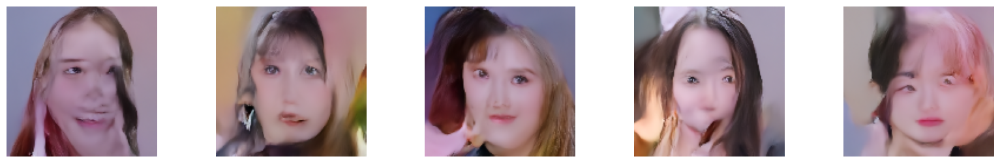

36/36 [==============================] - 37s 932ms/step - n_loss: 0.0896 - lr: 1.0000e-05
Epoch 2/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0902
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_001.png


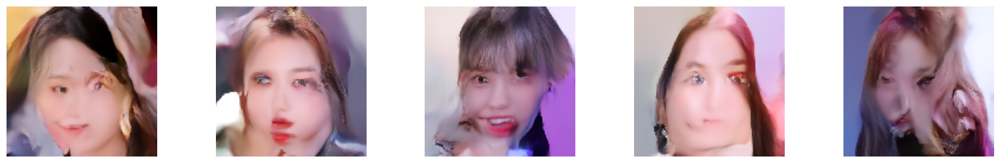

36/36 [==============================] - 37s 937ms/step - n_loss: 0.0903 - lr: 1.0000e-05
Epoch 3/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0897
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_002.png


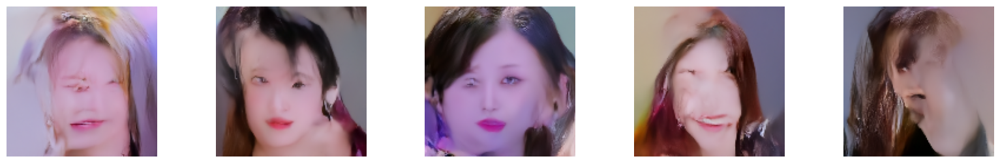

36/36 [==============================] - 38s 940ms/step - n_loss: 0.0897 - lr: 1.0000e-05
Epoch 4/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0911
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_003.png


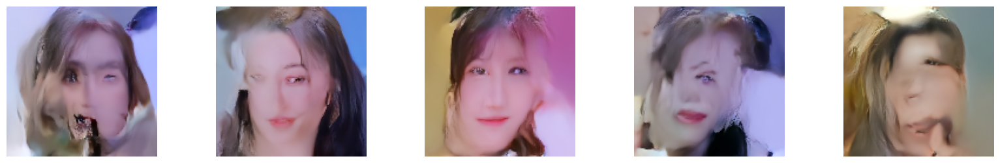

36/36 [==============================] - 38s 942ms/step - n_loss: 0.0911 - lr: 1.0000e-05
Epoch 5/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0911
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_004.png


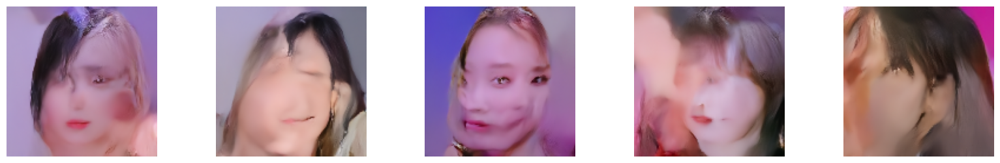

36/36 [==============================] - 38s 944ms/step - n_loss: 0.0911 - lr: 1.0000e-05
Epoch 6/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0910
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_005.png


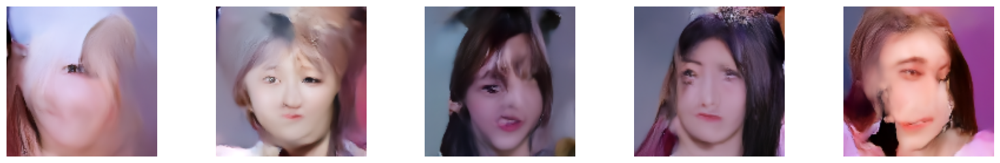

36/36 [==============================] - 38s 954ms/step - n_loss: 0.0910 - lr: 1.0000e-05
Epoch 7/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0905
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_006.png


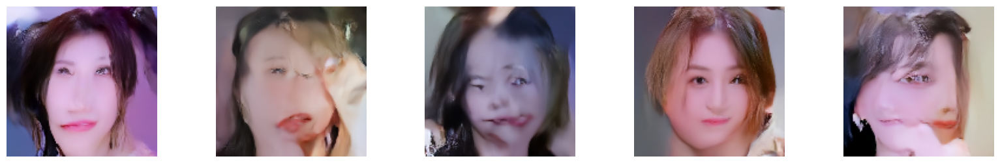

36/36 [==============================] - 38s 948ms/step - n_loss: 0.0905 - lr: 1.0000e-05
Epoch 8/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0909
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_007.png


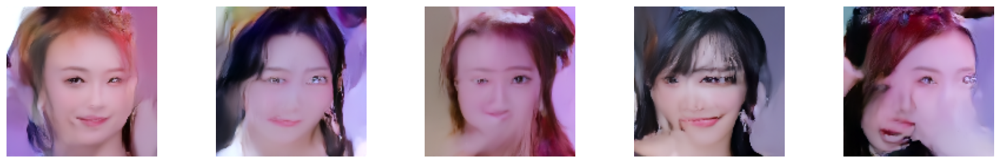

36/36 [==============================] - 38s 947ms/step - n_loss: 0.0909 - lr: 1.0000e-05
Epoch 9/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0899
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_008.png


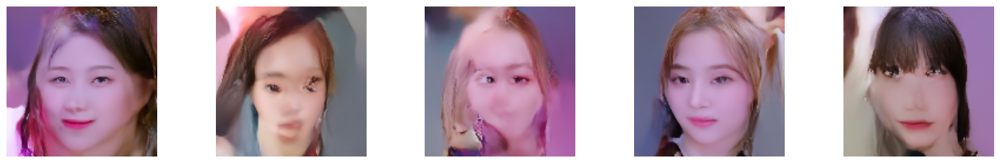

36/36 [==============================] - 38s 947ms/step - n_loss: 0.0899 - lr: 1.0000e-05
Epoch 10/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0900
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_009.png


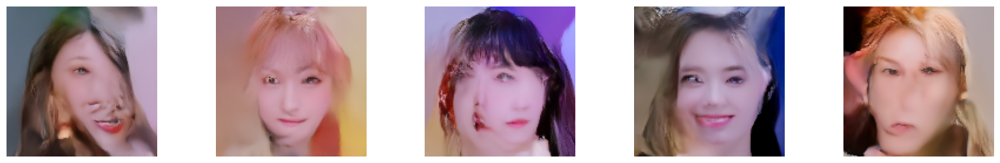

36/36 [==============================] - 38s 950ms/step - n_loss: 0.0900 - lr: 1.0000e-05
Epoch 11/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0904
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_010.png


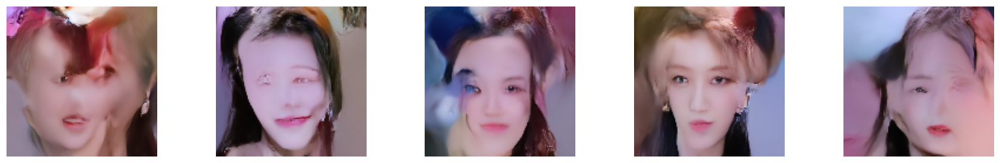

36/36 [==============================] - 38s 949ms/step - n_loss: 0.0905 - lr: 1.0000e-05
Epoch 12/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0908
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_011.png


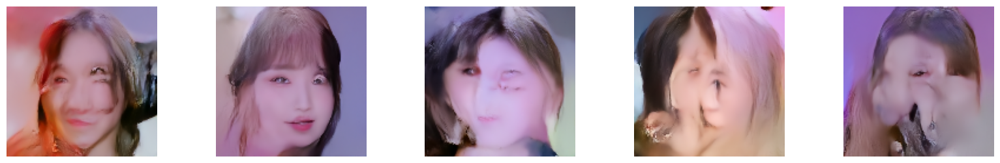

36/36 [==============================] - 38s 948ms/step - n_loss: 0.0908 - lr: 1.0000e-05
Epoch 13/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0902
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_012.png


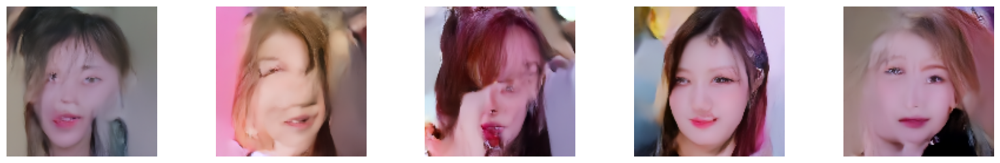

36/36 [==============================] - 38s 950ms/step - n_loss: 0.0902 - lr: 1.0000e-05
Epoch 14/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0911
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_013.png


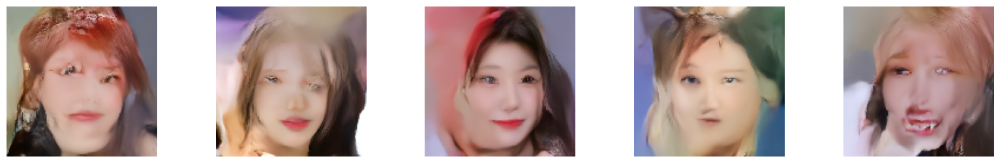

36/36 [==============================] - 38s 949ms/step - n_loss: 0.0911 - lr: 1.0000e-05
Epoch 15/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0910
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_014.png


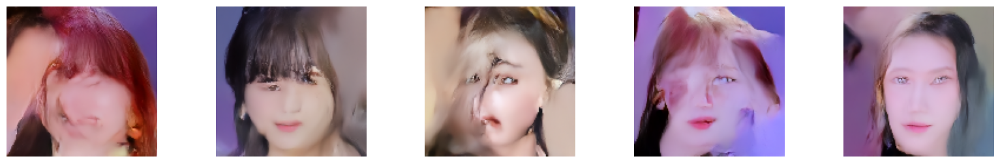

36/36 [==============================] - 38s 949ms/step - n_loss: 0.0910 - lr: 1.0000e-05
Epoch 16/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0905
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_015.png


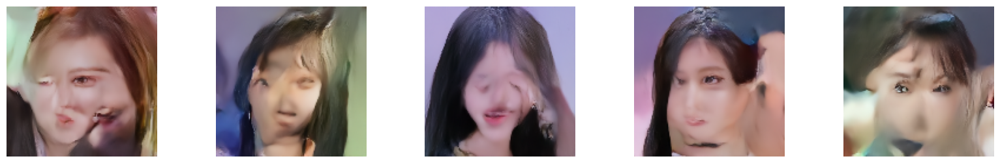

36/36 [==============================] - 38s 958ms/step - n_loss: 0.0905 - lr: 1.0000e-05
Epoch 17/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0896
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_016.png


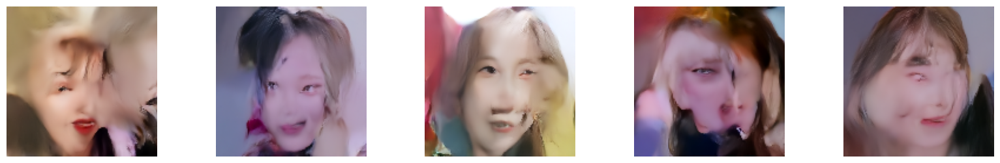

36/36 [==============================] - 38s 947ms/step - n_loss: 0.0897 - lr: 1.0000e-05
Epoch 18/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0907
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_017.png


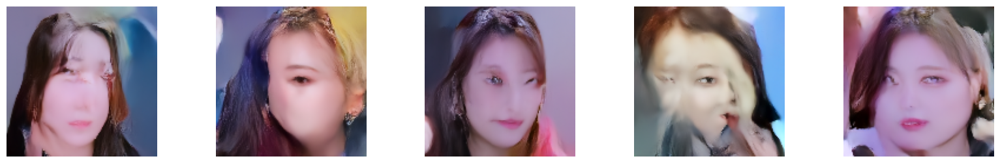

36/36 [==============================] - 38s 948ms/step - n_loss: 0.0908 - lr: 1.0000e-05
Epoch 19/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0904
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_018.png


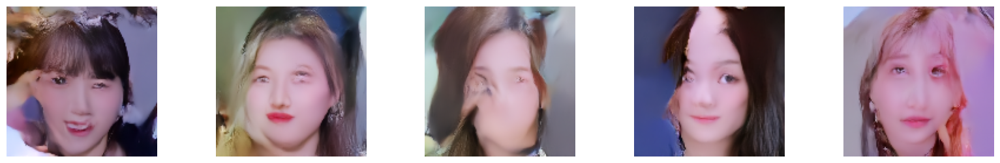

36/36 [==============================] - 38s 950ms/step - n_loss: 0.0905 - lr: 1.0000e-05
Epoch 20/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0908
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_019.png


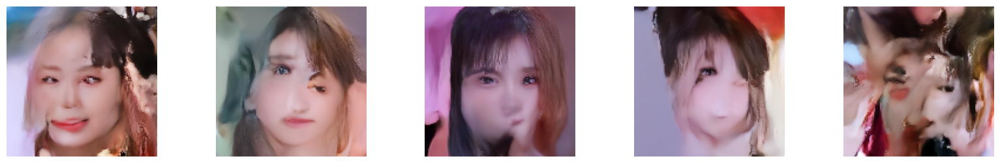

36/36 [==============================] - 38s 948ms/step - n_loss: 0.0908 - lr: 1.0000e-05
Epoch 21/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0898
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_020.png


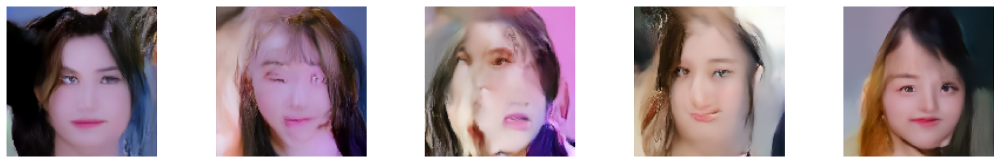

36/36 [==============================] - 38s 950ms/step - n_loss: 0.0898 - lr: 1.0000e-05
Epoch 22/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0907
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_021.png


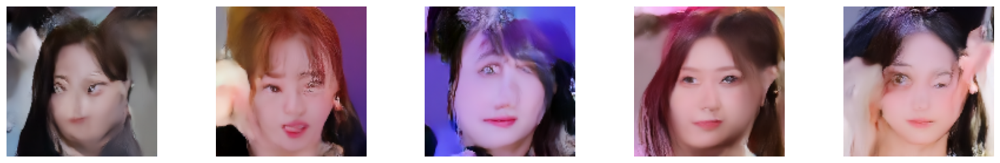

36/36 [==============================] - 38s 949ms/step - n_loss: 0.0908 - lr: 1.0000e-05
Epoch 23/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0904
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_022.png


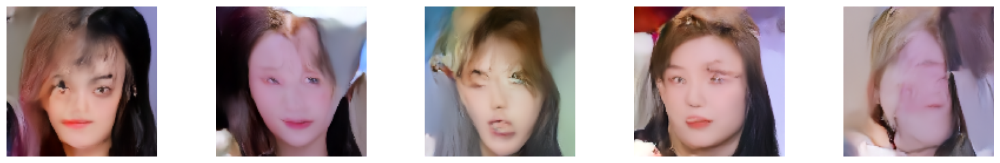

36/36 [==============================] - 38s 950ms/step - n_loss: 0.0904 - lr: 1.0000e-05
Epoch 24/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0897
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_023.png


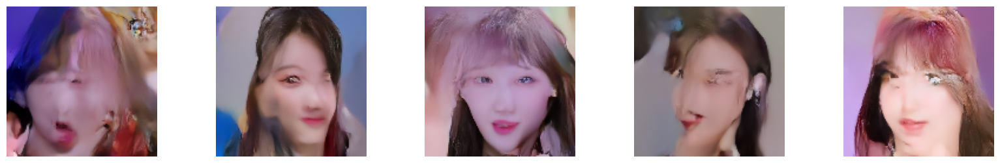

36/36 [==============================] - 38s 952ms/step - n_loss: 0.0898 - lr: 1.0000e-05
Epoch 25/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0909
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_024.png


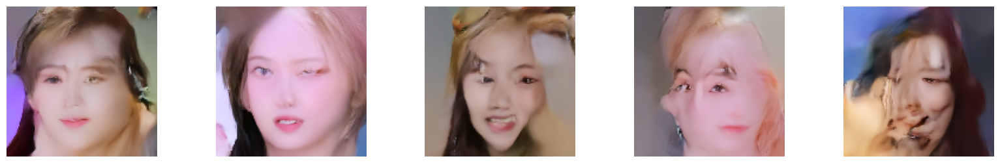

36/36 [==============================] - 38s 948ms/step - n_loss: 0.0910 - lr: 1.0000e-05
Epoch 26/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0914
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_025.png


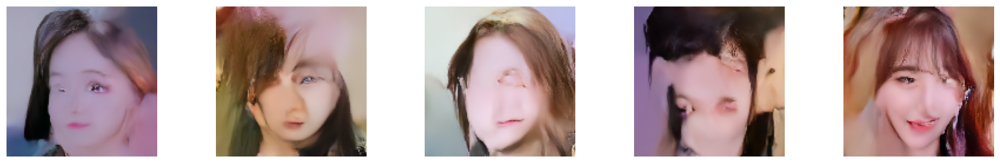

36/36 [==============================] - 38s 950ms/step - n_loss: 0.0914 - lr: 1.0000e-05
Epoch 27/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0915
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_026.png


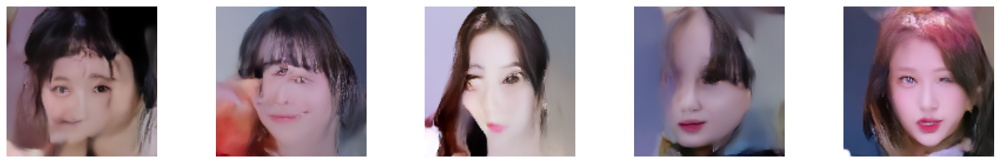

36/36 [==============================] - 38s 958ms/step - n_loss: 0.0916 - lr: 1.0000e-05
Epoch 28/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0900
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_027.png


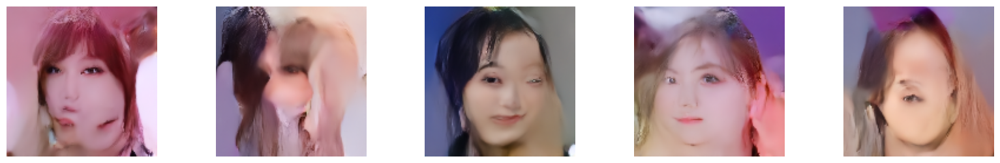

36/36 [==============================] - 38s 950ms/step - n_loss: 0.0900 - lr: 1.0000e-05
Epoch 29/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0916
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_028.png


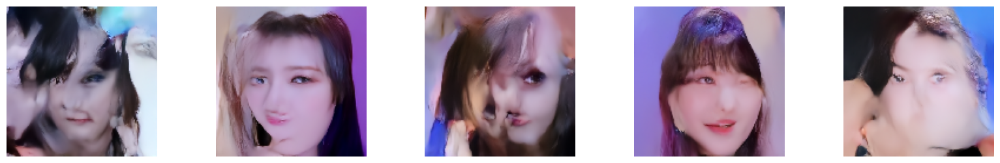

36/36 [==============================] - 38s 952ms/step - n_loss: 0.0916 - lr: 1.0000e-05
Epoch 30/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0900
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_029.png


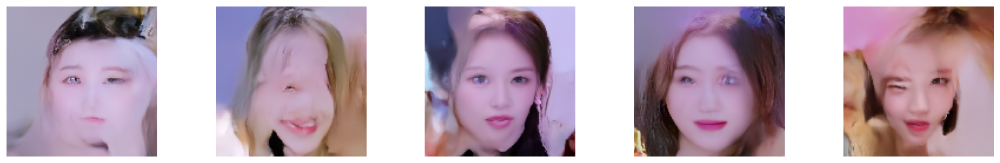

36/36 [==============================] - 38s 953ms/step - n_loss: 0.0900 - lr: 1.0000e-05
Epoch 31/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0907
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_030.png


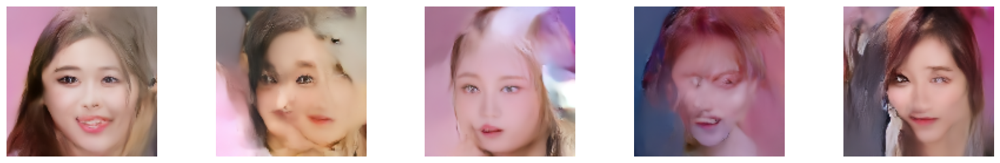

36/36 [==============================] - 38s 953ms/step - n_loss: 0.0907 - lr: 1.0000e-05
Epoch 32/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0903
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_031.png


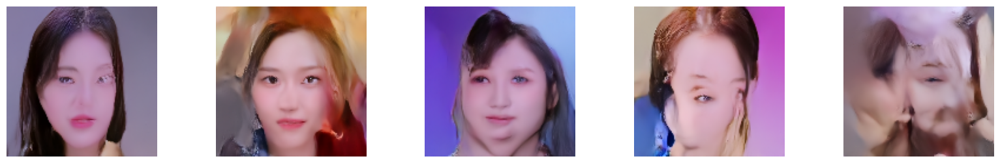

36/36 [==============================] - 38s 954ms/step - n_loss: 0.0903 - lr: 1.0000e-05
Epoch 33/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0910
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_032.png


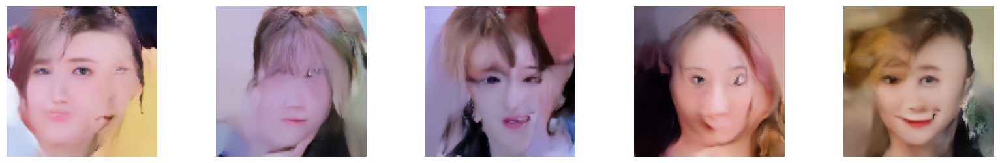

36/36 [==============================] - 38s 954ms/step - n_loss: 0.0910 - lr: 1.0000e-05
Epoch 34/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0905
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_033.png


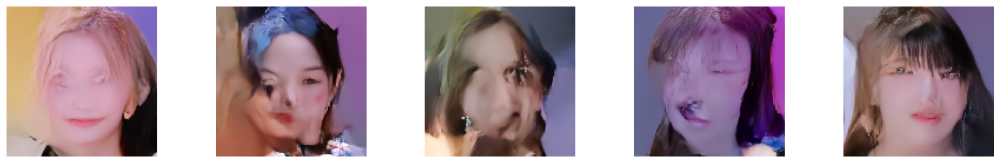

36/36 [==============================] - 38s 953ms/step - n_loss: 0.0905 - lr: 1.0000e-05
Epoch 35/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0912
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_034.png


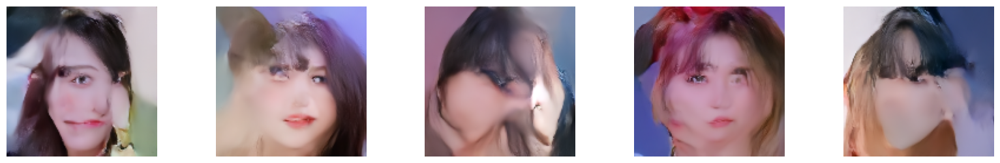

36/36 [==============================] - 38s 954ms/step - n_loss: 0.0913 - lr: 1.0000e-05
Epoch 36/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0901
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_035.png


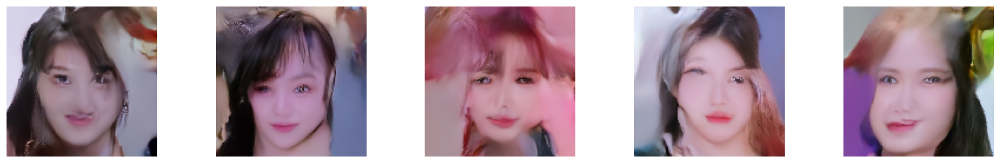

36/36 [==============================] - 38s 954ms/step - n_loss: 0.0901 - lr: 1.0000e-05
Epoch 37/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0907
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_036.png


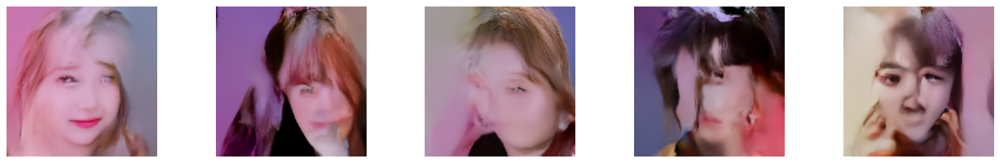

36/36 [==============================] - 38s 953ms/step - n_loss: 0.0908 - lr: 1.0000e-05
Epoch 38/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0907
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_037.png


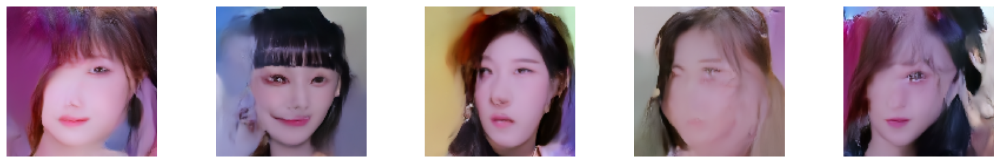

36/36 [==============================] - 38s 962ms/step - n_loss: 0.0907 - lr: 1.0000e-05
Epoch 39/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0894
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_038.png


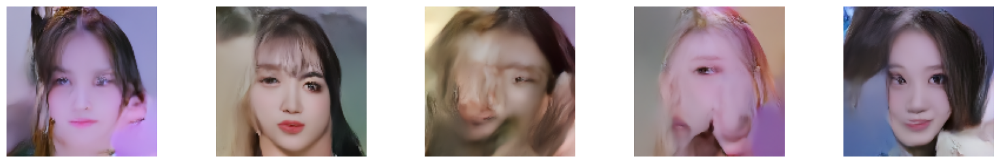

36/36 [==============================] - 38s 954ms/step - n_loss: 0.0894 - lr: 1.0000e-05
Epoch 40/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0905
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_039.png


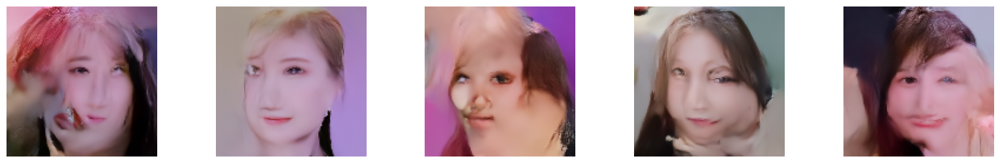

36/36 [==============================] - 38s 952ms/step - n_loss: 0.0906 - lr: 1.0000e-05
Epoch 41/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0898
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_040.png


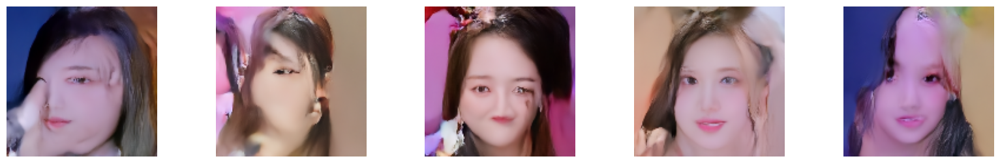

36/36 [==============================] - 38s 953ms/step - n_loss: 0.0898 - lr: 1.0000e-05
Epoch 42/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0913
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_041.png


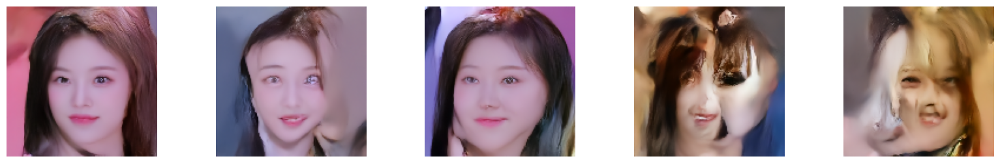

36/36 [==============================] - 38s 952ms/step - n_loss: 0.0913 - lr: 1.0000e-05
Epoch 43/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0905
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_042.png


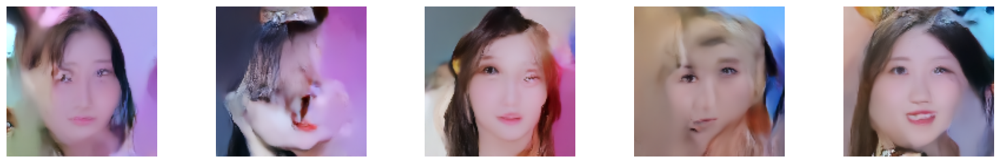

36/36 [==============================] - 38s 954ms/step - n_loss: 0.0906 - lr: 1.0000e-05
Epoch 44/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0909
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_043.png


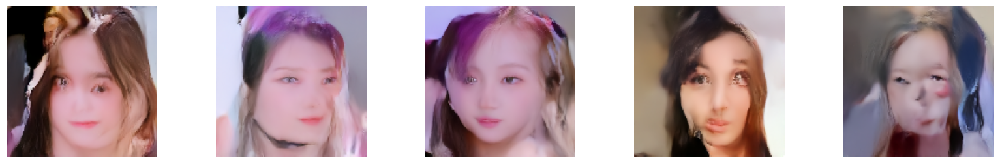

36/36 [==============================] - 38s 952ms/step - n_loss: 0.0909 - lr: 1.0000e-05
Epoch 45/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0903
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_044.png


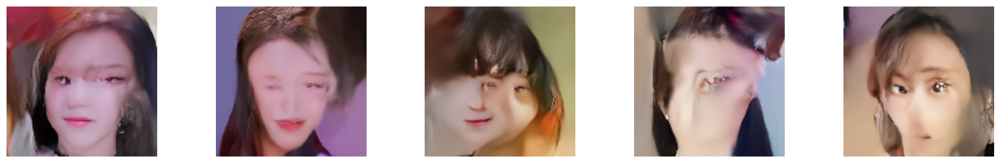

36/36 [==============================] - 38s 953ms/step - n_loss: 0.0903 - lr: 1.0000e-05
Epoch 46/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0902
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_045.png


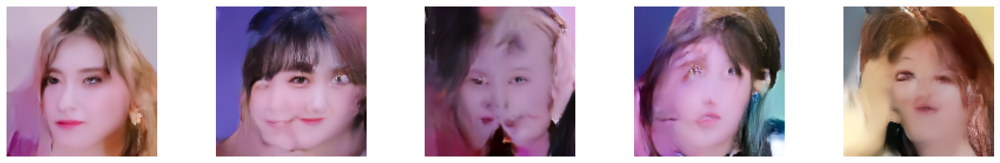

36/36 [==============================] - 38s 951ms/step - n_loss: 0.0903 - lr: 1.0000e-05
Epoch 47/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0909
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_046.png


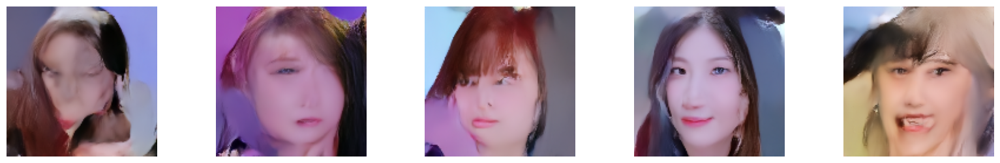

36/36 [==============================] - 38s 953ms/step - n_loss: 0.0909 - lr: 1.0000e-05
Epoch 48/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0896
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_047.png


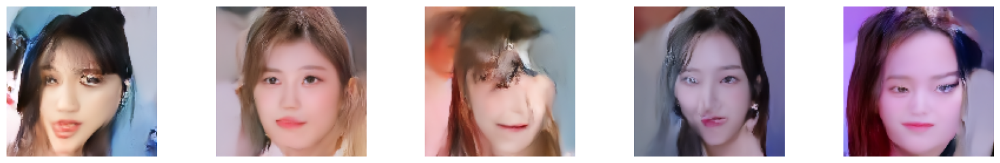

36/36 [==============================] - 38s 962ms/step - n_loss: 0.0896 - lr: 1.0000e-05
Epoch 49/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0905
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_048.png


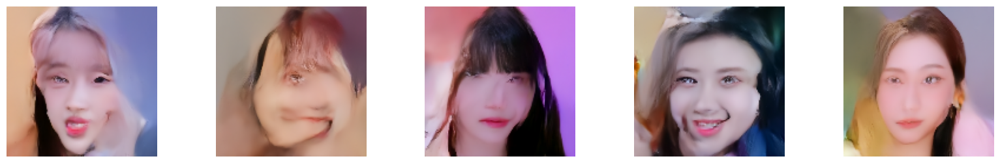

36/36 [==============================] - 38s 953ms/step - n_loss: 0.0906 - lr: 1.0000e-05
Epoch 50/50
35/36 [============================>.] - ETA: 0s - n_loss: 0.0898
Saved to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_049.png


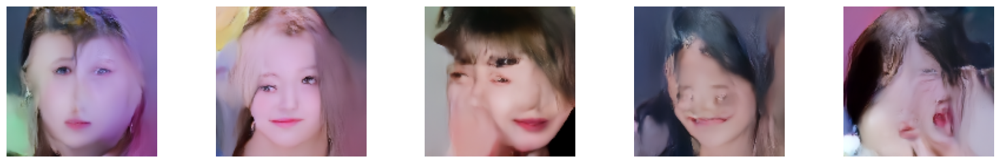

36/36 [==============================] - 38s 951ms/step - n_loss: 0.0899 - lr: 1.0000e-05


In [ ]:
# run training and plot generated images periodically
model_checkpoint_callback = callbacks.ModelCheckpoint(
    filepath="/content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/checkpoints2/checkpoint.ckpt",
    save_weights_only=True,
    save_freq="epoch",
    verbose=0,
)

tensorboard_callback = callbacks.TensorBoard(log_dir="./logs")


class ImageGenerator(callbacks.Callback):
    def __init__(self, num_img):
        self.num_img = num_img

    def on_epoch_end(self, epoch, logs=None):
        generated_images = self.model.generate(
            num_images=self.num_img,
            diffusion_steps=PLOT_DIFFUSION_STEPS,
        ).numpy()
        display(
            generated_images,
            save_to="/content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/output8/generated_img_%03d.png" % (epoch),
        )


image_generator_callback = ImageGenerator(num_img=10) # change num_img=5

ddm.fit(
    train,
    epochs=EPOCHS,
    callbacks=[
        model_checkpoint_callback,
        tensorboard_callback,
        image_generator_callback,
        WandbCallback(),
        reduce_lr # adding reduce lr callback
    ],
)


In [ ]:
# Save the Model
# Optional: Save the model directly to wandb at the end of training
model_path = wandb.run.dir + "/model"
ddm.save(model_path, save_format='tf')
wandb.save(model_path + "/*")

ValueError: Model <__main__.DiffusionModel object at 0x7ac3246846a0> cannot be saved either because the input shape is not available or because the forward pass of the model is not defined.To define a forward pass, please override `Model.call()`. To specify an input shape, either call `build(input_shape)` directly, or call the model on actual data using `Model()`, `Model.fit()`, or `Model.predict()`. If you have a custom training step, please make sure to invoke the forward pass in train step through `Model.__call__`, i.e. `model(inputs)`, as opposed to `model.call()`.

In [ ]:
# Stop wandb tracking after training
wandb.finish()

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇███
n_loss,▂▄▂▆▆▄▆▃▄▅▃▆▅▂▅▅▂▅▄▂▇█▃█▅▄▆▄▃▅▅▁▂▇▅▆▄▆▂▂
epoch,49
n_loss,0.0899


### Let's generate some images from our model

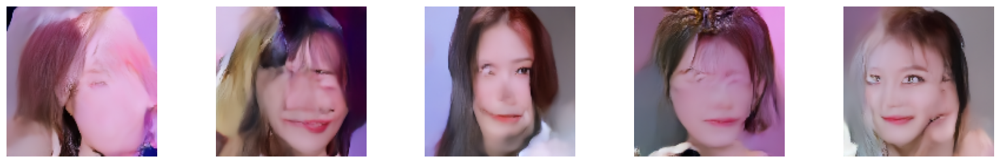

In [ ]:
# Generate some novel images of kpop idols
generated_images = ddm.generate(num_images=10, diffusion_steps=20).numpy()
display(generated_images)

### Generate separate images

In [ ]:
# Function for generating
import os
from datetime import datetime

def save_generated_images(model, num_images, diffusion_steps, save_path):
    # Generate images using the model
    generated_images = model.generate(num_images=num_images, diffusion_steps=diffusion_steps).numpy()

    # Ensure the save path exists
    if not os.path.exists(save_path):
        os.makedirs(save_path)

    # Get current date for filename
    current_date = datetime.now().strftime("%Y-%m-%d")

    # Save each image as a PNG file
    for i, img in enumerate(generated_images):
        # Normalize image to range [0, 1] if needed
        if img.max() > 1.0:
            img = img / 255.0
        filename = os.path.join(save_path, f'generated_image_{i+1}_{current_date}.png')
        plt.imsave(filename, img)

    print(f"Saved {num_images} images to {save_path}")

In [ ]:
# generate and save images.
save_generated_images(ddm, num_images=50, diffusion_steps=40, save_path='/content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/generated_img')


Saved 50 images to /content/drive/MyDrive/ML_experiments/GenDeepLearnModels/ddm-kpop-128/generated_img


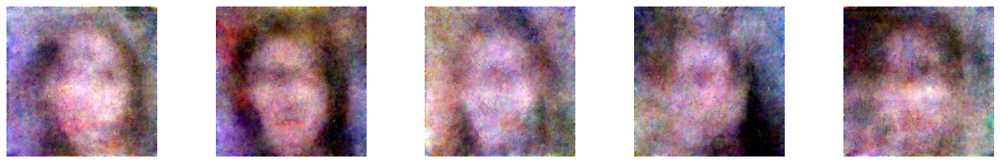

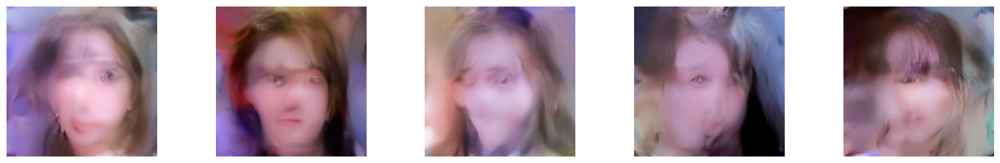

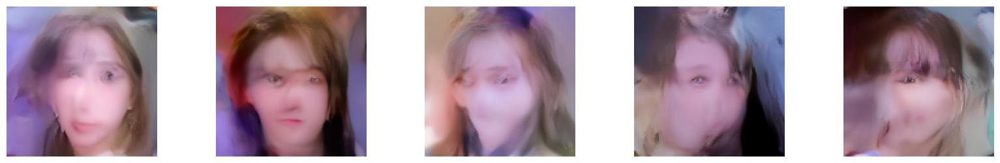

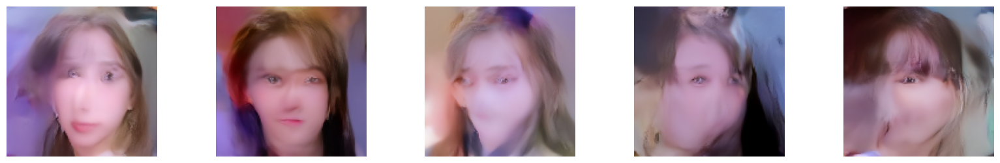

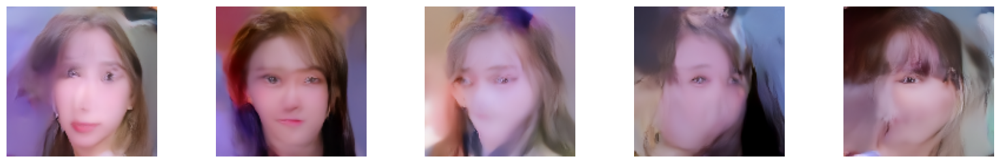

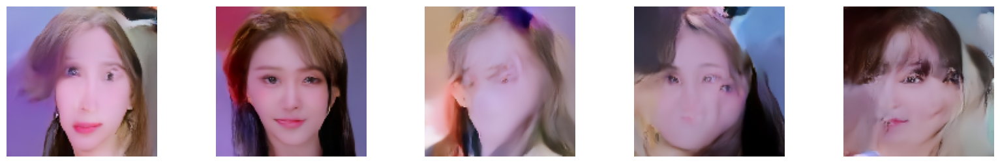

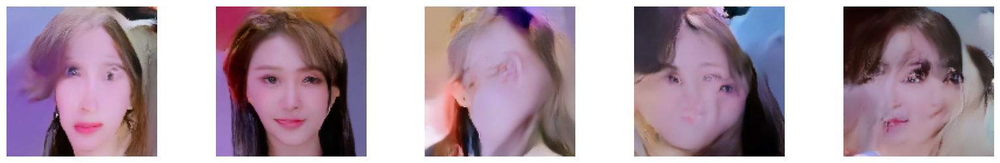

In [ ]:
# View improvement over greater number of diffusion steps
for diffusion_steps in list(np.arange(1, 6, 1)) + [20] + [100]:
    tf.random.set_seed(42)
    generated_images = ddm.generate(
        num_images=10,
        diffusion_steps=diffusion_steps,
    ).numpy()
    display(generated_images)

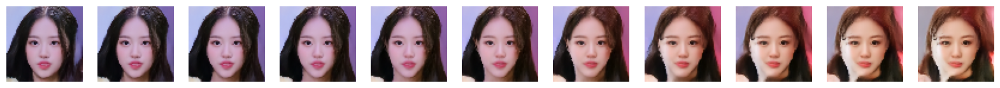

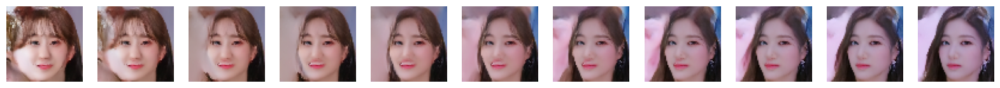

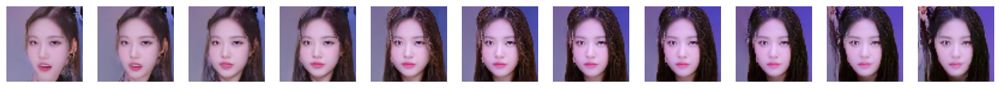

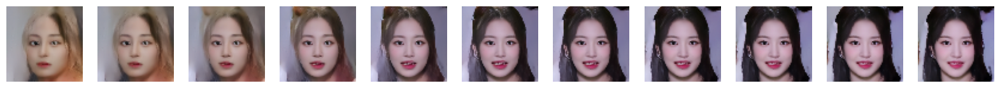

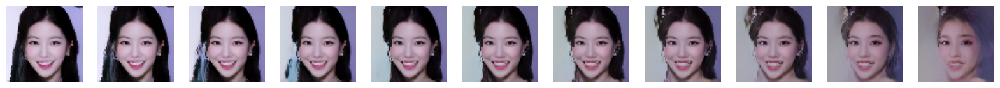

In [ ]:
# Interpolation between two points in the latent space
tf.random.set_seed(100)


def spherical_interpolation(a, b, t):
    return np.sin(t * math.pi / 2) * a + np.cos(t * math.pi / 2) * b


for i in range(5):
    a = tf.random.normal(shape=(IMAGE_SIZE, IMAGE_SIZE, 3))
    b = tf.random.normal(shape=(IMAGE_SIZE, IMAGE_SIZE, 3))
    initial_noise = np.array(
        [spherical_interpolation(a, b, t) for t in np.arange(0, 1.1, 0.1)]
    )
    generated_images = ddm.generate(
        num_images=2, diffusion_steps=20, initial_noise=initial_noise
    ).numpy()
    display(generated_images, n=11)